# Topic Modelling of CNN News Articles  
#### Capstone Project - Notebook 2 of 2  &emsp; &emsp; &emsp; By: Leanna Lo
---

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from scipy import stats
from scipy.stats import norm 

In [76]:
import plotly.graph_objects as go
import plotly.express as px

In [4]:
from sklearn.feature_extraction.text import CountVectorizer
import nltk, string, re
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/leannalo/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [6]:
import gensim
from gensim.models import Word2Vec
from gensim.models.phrases import Phrases, Phraser
from time import time


In [7]:
import hdbscan
import umap.umap_ as umap
import sklearn.cluster as cluster
from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score
import matplotlib as mpl

from scipy.spatial.distance import cdist

%matplotlib inline
sns.set_context('poster')
sns.set_style('white')
sns.set_color_codes()

plot_kwds={'alpha':0.25, 's':60, 'linewidths':0}
palette = sns.color_palette('deep', 12)

from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.model_selection import RandomizedSearchCV

### Table of Contents
- [Data_Preparation](#Data-Preparation) 
- [Word2vec Model](#Word2vec-Model)
- [HDBSCAN_Clustering](#HDBSCAN-Clustering)
- [Cluster_Identification](#Cluster-Identification)
- [Similarity_Score](#Similarity-Score)


### Data Preparation
---

We will first re-run all the data pre-processing/wrangling changes we made in the first notebook. 

In [9]:
df_raw = pd.read_csv('CNN_Articels_clean.csv')

In [10]:
#Drop values with NA article text
df_raw.dropna(inplace=True)

In [11]:
#new df shape
df_raw.shape

(37940, 11)

In [12]:
#Drop index column
df = df_raw.drop(['Index'], axis=1).copy()

In [13]:
#Convert 'Date published' column to date/time datatype. 
df['Date']=df['Date published'].astype("datetime64")

In [14]:
#Create month and year columns
df['Month published'] = pd.to_datetime(df['Date published']).dt.month
df['Year published'] = pd.to_datetime(df['Date published']).dt.year
df['Month_year published'] = pd.to_datetime(df['Date published']).dt.to_period('M')
#Drop Date published column
df = df.drop(['Date published'],axis=1)
df.head()

,Author,Category,Section,Url,Headline,Description,Keywords,Second headline,Article text,Date,Month published,Year published,Month_year published
0,"Jacopo Prisco, CNN",news,world,https://www.cnn.com/2021/07/14/world/tusimple-...,"There's a shortage of truckers, but TuSimple t...",The e-commerce boom has exacerbated a global t...,"world, There's a shortage of truckers, but TuS...","There's a shortage of truckers, but TuSimple t...","(CNN)Right now, there's a shortage of truck d...",2021-07-15 02:46:59,7,2021,2021-07
1,"Stephanie Bailey, CNN",news,world,https://www.cnn.com/2021/05/12/world/ironhand-...,Bioservo's robotic 'Ironhand' could protect fa...,Working in a factory can mean doing the same t...,"world, Bioservo's robotic 'Ironhand' could pro...",A robotic 'Ironhand' could protect factory wor...,(CNN)Working in a factory or warehouse can me...,2021-05-12 07:52:09,5,2021,2021-05
2,"Words by Stephanie Bailey, video by Zahra Jamshed",news,asia,https://www.cnn.com/2021/06/15/asia/swarm-robo...,This swarm of robots gets smarter the more it ...,"In a Hong Kong warehouse, a swarm of autonomou...","asia, This swarm of robots gets smarter the mo...",This swarm of robots gets smarter the more it ...,"(CNN)In a Hong Kong warehouse, a swarm of aut...",2021-06-16 02:51:30,6,2021,2021-06
3,Kathryn Vasel,business,success,https://www.cnn.com/2022/03/18/success/pandemi...,"Two years later, remote work has changed milli...",Here's a look at how the pandemic reshaped peo...,"success, Two years later, remote work has chan...","Two years later, remote work has changed milli...",The pandemic thrust the working world into a n...,2022-03-18 14:37:21,3,2022,2022-03
4,"Paul R. La Monica, CNN Business",business,investing,https://www.cnn.com/2022/03/19/investing/march...,Why March is so volatile for stocks - CNN,March Madness isn't just for college basketbal...,"investing, Why March is so volatile for stocks...",Why March is so volatile for stocks,New York (CNN Business)March Madness isn't jus...,2022-03-19 11:41:08,3,2022,2022-03


In [15]:
#Create separate df for just columns needed
text_df = df[['Year published','Month_year published','Category','Section','Article text']]
text_df.head()

,Year published,Month_year published,Category,Section,Article text
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d..."
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut..."
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...


### Word2vec Model
---

In [16]:
#Convert data type to string
text_df = text_df.astype(dtype=str)

In [17]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
print(len(stop_words))
#Extend stop words
stop_words.extend(['said','say','photo','caption','hide','story','highlights','cnn'])
print(len(stop_words))

179
187


In [18]:
#Define function to clean text
wnl = nltk.stem.WordNetLemmatizer()
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
#Extend stop words
stop_words.extend(['said','say','photo','caption','hide','story','highlights','cnn'])

def text_cleaner(content):
    #convert to lowercase, remove punctuation/special characters, and leading spaces
    content = re.sub(r'[^\w\s]','',str(content).lower().strip())
    
    #Split into tokens
    content_tokens  = content.split()
    
    #remove stopwords
    content_tokens = [word for word in content_tokens if word not in stop_words]
    
    #lemmatizing
    content_tokens = [wnl.lemmatize(word) for word in content_tokens]
    
    #re-join list of strings
    content_cleaned = ' '.join(content_tokens)
    return content_cleaned

In [17]:
stop_words

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [19]:
#Clean article text column
text_df['Article text_cleaned'] = text_df['Article text'].apply(lambda x: text_cleaner(x))

In [20]:
text_df.head()

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",cnnright there shortage truck driver u worldwi...
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,cnnworking factory warehouse mean task repetit...
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",cnnin hong kong warehouse swarm autonomous rob...
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...


In [20]:
#CNN is still in dataset.
#Check if added stop words still in dataset
text_df['Article text_cleaned'].str.contains('caption').value_counts()

False    37883
True        57
Name: Article text_cleaned, dtype: int64

In [21]:
#Run a loop to remove words
new_stopwords = ['said','say','photo','caption','hide','story','highlights','cnn']
for word in new_stopwords:
    text_df['Article text_cleaned']=text_df['Article text_cleaned'].str.replace(word,'')

In [22]:
text_df.head()

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...


In [23]:
text_df['Article text_cleaned'].str.contains('caption').value_counts()

False    37940
Name: Article text_cleaned, dtype: int64

In [24]:
#Split article text_cleaned column into list
text_df['Article text_tokens']=text_df['Article text_cleaned'].apply(lambda x: str(x).split(" "))

In [25]:
text_df.head()

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"[right, there, shortage, truck, driver, u, wor..."
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"[working, factory, warehouse, mean, task, repe..."
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"[in, hong, kong, warehouse, swarm, autonomous,..."
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"[pandemic, thrust, working, world, new, realit..."
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"[new, york, businessmarch, madness, isnt, coll..."


In [26]:
#Import W2V df
wordvecdf = pd.read_csv('wordvecdf.csv')
wordvecdf.drop(columns='Unnamed: 0',inplace=True)

In [27]:
wordvecdf.head()

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,-0.016032,0.036158,0.021758,0.022803,0.001016,0.068050,0.013594,-0.048604,-0.021782,0.054503,...,-0.017896,0.056622,0.028188,0.013143,0.053919,-0.024214,-0.050713,-0.004868,0.005487,0.000863
1,-0.002284,0.030380,0.027968,0.030808,-0.004694,0.047021,0.009928,-0.048003,-0.006568,0.042968,...,-0.012350,0.066372,0.029813,0.004806,0.055124,-0.015744,-0.051678,-0.023580,-0.004797,0.008216
2,-0.003055,0.036096,0.030872,0.032210,0.000975,0.052155,0.011467,-0.040475,-0.009455,0.046530,...,-0.007525,0.060721,0.031334,0.010828,0.051906,-0.018540,-0.056767,-0.016749,-0.000749,0.006850
3,-0.011465,0.030225,0.007033,0.010886,0.010885,0.075397,0.021948,-0.061104,-0.021921,0.057037,...,0.012001,0.074439,0.059572,0.011339,0.048577,-0.038702,-0.027890,-0.007635,-0.026839,0.002056
4,-0.041143,0.015323,0.010969,0.011139,-0.018571,0.037636,0.005234,-0.033403,-0.025339,0.031668,...,-0.029925,0.054813,0.007475,0.007812,0.027933,-0.017162,-0.050722,0.038444,0.006989,-0.006163


### HDBSCAN Clustering
---

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


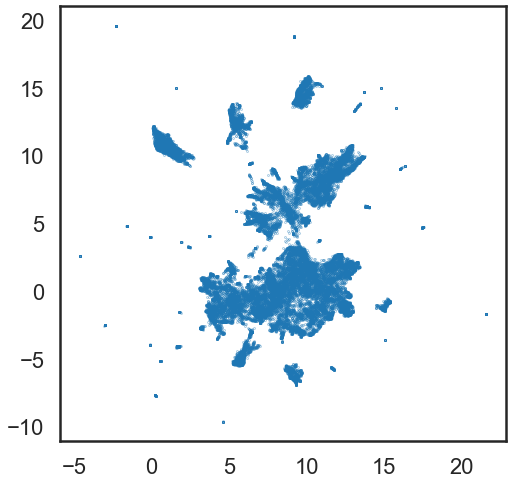

In [28]:
#First view data using UMAP for visualization
standard_embedding = umap.UMAP(random_state=42).fit_transform(wordvecdf)
plt.figure(figsize=(8,8))
plt.scatter(standard_embedding[:, 0], standard_embedding[:, 1], s=0.1, cmap='Spectral');

In [29]:
#We will reduce 300 dimensions to 50 using UMAP
clusterable_embedding = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    n_components=50,
    random_state=42,
).fit_transform(wordvecdf)

In [30]:
clusterable_embedding

array([[10.258352 ,  8.674925 ,  4.314297 , ...,  6.9209156,  6.40848  ,
         7.475535 ],
       [10.26529  ,  8.673208 ,  4.2959847, ...,  6.9212523,  6.408174 ,
         7.477127 ],
       [10.265115 ,  8.673055 ,  4.2947574, ...,  6.921073 ,  6.4082885,
         7.4769044],
       ...,
       [ 8.665244 ,  8.898324 ,  7.6360297, ...,  6.9780097,  6.274383 ,
         7.5247335],
       [11.132308 ,  8.4796715,  2.154809 , ...,  6.930298 ,  6.3888845,
         7.489919 ],
       [10.507742 ,  8.577293 ,  3.9605594, ...,  7.057009 ,  6.358603 ,
         7.5244837]], dtype=float32)

In [31]:
#Run pipeline
hdb = hdbscan.HDBSCAN(gen_min_span_tree=True).fit(clusterable_embedding)

# specify parameters and distributions to sample from
#The amount of data classified as noise is controlled by the min_samples parameter. By default, if not otherwise set, this value is set to the same value as min_cluster_size. 
param_dist = {'min_cluster_size':[5,10,15,20,25,30,40,50], 
              'min_samples': [10,15,20,25,30,40,45,50],
              'cluster_selection_epsilon':[0.1,0.2,0.3,0.4,0.5,0.6],
              'cluster_selection_method' : ['eom','leaf'],
              'metric' : ['euclidean','manhattan'] 
             }

#validity_scorer = "hdbscan__hdbscan___HDBSCAN__validity_index"
validity_scorer = make_scorer(hdbscan.validity.validity_index,greater_is_better=True)


random_search = RandomizedSearchCV(hdb
                                   ,param_distributions=param_dist
                                   ,scoring=validity_scorer 
                                   ,random_state=42)

random_search.fit(clusterable_embedding)


print(f"Best Parameters {random_search.best_params_}")
print(f"Validity score :{random_search.best_estimator_.relative_validity_}")


/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_test)
TypeError: __call__() missing 1 required positional argument: 'y_true'

  warnings.warn(
/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_t

/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_test)
TypeError: __call__() missing 1 required positional argument: 'y_true'

  warnings.warn(
/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_t

/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_test)
TypeError: __call__() missing 1 required positional argument: 'y_true'

  warnings.warn(
/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_t

/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_test)
TypeError: __call__() missing 1 required positional argument: 'y_true'

  warnings.warn(
/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 765, in _score
    scores = scorer(estimator, X_t

Best Parameters {'min_samples': 45, 'min_cluster_size': 25, 'metric': 'manhattan', 'cluster_selection_method': 'eom', 'cluster_selection_epsilon': 0.5}
Validity score :0.37820347316471


We will run the model on the parameters above. The validity score is 37.8%- not terrible but not the best. 

In [36]:
#Instantiate HDBSCAN, fit and predict on UMAP-reduced data using identified hyperparameters.
model = hdbscan.HDBSCAN(min_samples=45, min_cluster_size=25,gen_min_span_tree=True,\
                        metric='manhattan',cluster_selection_method='eom',cluster_selection_epsilon=0.5)
labels = model.fit_predict(clusterable_embedding)

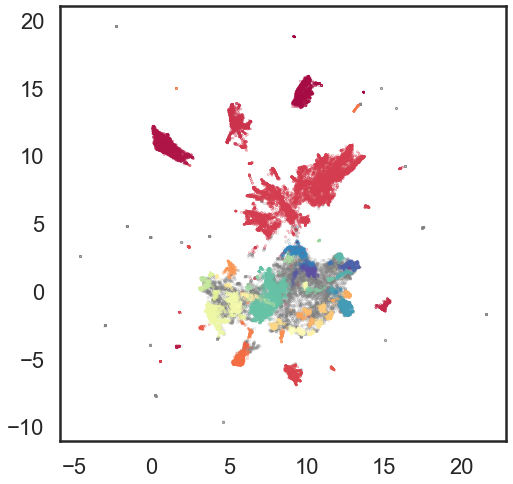

In [37]:
#visualize clusters
clustered = (labels >= 0)
plt.figure(figsize=(8,8))
plt.scatter(standard_embedding[~clustered, 0],
            standard_embedding[~clustered, 1],
            color=(0.5, 0.5, 0.5),
            s=0.1,
            alpha=0.5)
plt.scatter(standard_embedding[clustered, 0],
            standard_embedding[clustered, 1],
            c=labels[clustered],
            s=0.1,
            cmap='Spectral');

In [38]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels))-(1 if -1 in labels else 0)
print('Estimated number of clusters:%d' % n_clusters_)

Estimated number of clusters:61


In [39]:
model.relative_validity_

0.37820347316471

In [41]:
#Add labels/cluster ID to df
text_df['cluster ID']=labels

#Save new df to csv
text_df.to_csv('text_df_aug7.csv')

In [28]:
#Import df
text_df = pd.read_csv('text_df_aug7.csv')
text_df.drop(columns='Unnamed: 0',inplace=True)

In [29]:
#Look at cluster makeup in data
text_df['cluster ID'].value_counts(normalize=True)

-1     0.282130
 6     0.265894
 48    0.063759
 2     0.056827
 1     0.040511
         ...   
 53    0.001028
 35    0.000923
 45    0.000817
 51    0.000712
 56    0.000685
Name: cluster ID, Length: 62, dtype: float64

We can see that the majority of the data (28.2%) is under cluster -1 (which represents noise), with the second highest cluster making up under 27% of the data. Not great, but we will continue on and look at the top 30 words in each cluster. 

In [40]:
#look at biggest cluster
text_df[text_df['cluster ID']==-1]

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"[pandemic, thrust, working, world, new, realit...",-1
7,2022,2022-03,business,perspectives,This interview has been edited from its origin...,interview edited original version originally p...,"[interview, edited, original, version, origina...",-1
10,2022,2022-03,business,media,New York (CNN Business)A version of this artic...,new york businessa version article first appea...,"[new, york, businessa, version, article, first...",-1
11,2022,2022-03,business,media,New York (CNN)As Russia's attack on Ukraine c...,new york as russia attack ukraine continues in...,"[new, york, as, russia, attack, ukraine, conti...",-1
12,2022,2022-03,business,business,"New York (CNN Business)In 2018, Kohl's was a b...",new york businessin 2018 kohl bright spot bele...,"[new, york, businessin, 2018, kohl, bright, sp...",-1
...,...,...,...,...,...,...,...,...
37932,2022,2022-03,news,europe,Moscow (CNN)Russia's assault on Ukraine is jus...,moscow russias assault ukraine week old conseq...,"[moscow, russias, assault, ukraine, week, old,...",-1
37934,2022,2022-03,news,europe,"Uman, Ukraine (CNN)As air raid sirens blared ...",uman ukraine as air raid siren blared small uk...,"[uman, ukraine, as, air, raid, siren, blared, ...",-1
37936,2022,2022-03,news,europe,"Sighetu Marmatiei, Romania (CNN)Elena Holitsyn...",sighetu marmatiei romania elena holitsyna daug...,"[sighetu, marmatiei, romania, elena, holitsyna...",-1
37945,2022,2022-03,news,europe,"Lviv, Ukraine (CNN)A long line of men snakes o...",lviv ukraine a long line men snake unassuming ...,"[lviv, ukraine, a, long, line, men, snake, una...",-1


In [41]:
#look at second biggest cluster
text_df[text_df['cluster ID']==6]

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID
61,2022,2022-03,entertainment,entertainment,(CNN)The equivalent of missing what should be...,the equivalent missing easy layup winning time...,"[the, equivalent, missing, easy, layup, winnin...",6
64,2022,2022-03,sport,sport,(CNN)The Cleveland Browns have defended their...,the cleveland brown defended signing embattled...,"[the, cleveland, brown, defended, signing, emb...",6
67,2022,2022-03,sport,sport,(CNN)The Houston Texans have agreed to trade ...,the houston texan agreed trade embattled quart...,"[the, houston, texan, agreed, trade, embattled...",6
68,2022,2022-03,news,us,"(CNN)Longtime NFL reporter John Clayton, who ...",longtime nfl reporter john clayton known profe...,"[longtime, nfl, reporter, john, clayton, known...",6
69,2022,2022-03,sport,sport,(CNN)University of Pennsylvania swimmer Lia T...,university pennsylvania swimmer lia thomas fin...,"[university, pennsylvania, swimmer, lia, thoma...",6
...,...,...,...,...,...,...,...,...
37939,2022,2022-03,sport,sport,(CNN)Tampa Bay Buccaneers head coach Bruce Ar...,tampa bay buccaneer head coach bruce arians d...,"[tampa, bay, buccaneer, head, coach, bruce, ar...",6
37940,2022,2022-03,sport,football,(CNN)Swiss billionaire Hansjörg Wyss says he ...,swiss billionaire hansjörg wy want buy chelse...,"[swiss, billionaire, hansjörg, wy, , want, buy...",6
37943,2022,2022-03,sport,sport,"(CNN)What can't Ja Morant do?On Monday night,...",what cant ja morant doon monday night morant p...,"[what, cant, ja, morant, doon, monday, night, ...",6
37944,2022,2022-03,sport,sport,(CNN)Russian President Vladimir Putin has bee...,russian president vladimir putin stripped mult...,"[russian, president, vladimir, putin, stripped...",6


### Cluster Identification
---


Using Bag of Words, we will look at the top 30 words in each cluster. 

In [30]:
#Make sure tokens are as dtype string
text_df["Article text_tokens"]=text_df["Article text_tokens"].astype(dtype=str)

In [31]:
#Run bag of words on article text_tokens column
#Instantiate 
bagofwords = CountVectorizer(min_df=100, max_df=20000)

#Fit to column
bagofwords.fit(text_df["Article text_tokens"])

#Transform
small_transformed = bagofwords.transform(text_df["Article text_tokens"])
small_transformed

<37940x11838 sparse matrix of type '<class 'numpy.int64'>'
	with 9973035 stored elements in Compressed Sparse Row format>

In [112]:
small_transformed

<37940x11838 sparse matrix of type '<class 'numpy.int64'>'
	with 9973035 stored elements in Compressed Sparse Row format>

In [32]:
#Convert sparse matrix into a numpy array and put words into a df
clusteredarticletokens = pd.DataFrame(columns=bagofwords.get_feature_names(), data=small_transformed.toarray())

/Users/leannalo/opt/anaconda3/envs/deeplearning/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [113]:
#Save to feather
clusteredarticletokens.to_feather('clusteredarticletokens_aug7.feather')

In [33]:
text_df.reset_index(drop=True, inplace=True)

In [34]:
#Concatenate above df with category column
df_combined = pd.concat([text_df,clusteredarticletokens],axis=1)

In [35]:
df_combined

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,00,10,...,zhang,zidane,zimbabwe,zinedine,zlatan,zone,zoo,zoom,zurich,zverev
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"['right', 'there', 'shortage', 'truck', 'drive...",22,0,2,...,0,0,0,0,0,0,0,0,0,0
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"['working', 'factory', 'warehouse', 'mean', 't...",22,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"['in', 'hong', 'kong', 'warehouse', 'swarm', '...",22,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"['pandemic', 'thrust', 'working', 'world', 'ne...",-1,0,0,...,0,0,0,0,0,0,0,3,0,0
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"['new', 'york', 'businessmarch', 'madness', 'i...",18,0,2,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37935,2022,2022-03,sport,sport,(CNN)Russian President Vladimir Putin has bee...,russian president vladimir putin stripped mult...,"['russian', 'president', 'vladimir', 'putin', ...",6,0,0,...,0,0,0,0,0,0,0,0,0,0
37936,2022,2022-03,news,europe,"Lviv, Ukraine (CNN)A long line of men snakes o...",lviv ukraine a long line men snake unassuming ...,"['lviv', 'ukraine', 'a', 'long', 'line', 'men'...",-1,0,0,...,0,0,0,0,0,0,0,0,0,0
37937,2022,2022-03,sport,sport,(CNN)Major League Baseball (MLB) is postponin...,major league baseball mlb postponing march 31 ...,"['major', 'league', 'baseball', 'mlb', 'postpo...",6,0,0,...,0,0,0,0,0,0,0,0,0,0
37938,2013,2013-01,news,europe,Here's a look at the life of Mikhail Gorbachev...,here look life mikhail gorbachev former presid...,"['here', 'look', 'life', 'mikhail', 'gorbachev...",-1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [36]:
#Save to feather
df_combined.to_feather('df_combined.feather')

In [49]:
#Get list of all clusters
cluster_list = list(df_combined['cluster ID'].unique())
#Determine index in category
#cluster_index = df_combined['cluster ID']==cluster
top30words = pd.DataFrame()
for cluster in cluster_list: 
    #Append to df
    top30words = top30words.append({'cluster':cluster, \
                                    'top30words':list(df_combined[df_combined['cluster ID']==cluster].iloc[:,8:].sum().sort_values(ascending=False).index[:30])},\
                                  ignore_index=True)
          

/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  top30words = top30words.append({'cluster':cluster, \
/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_771/30012873.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

In [50]:
#View full column info
pd.set_option('display.max_colwidth', None) 

#display all rows
pd.set_option('display.max_rows', None)

display(top30words)

In [52]:
#as it seems cluster numbers that are closer together are related, sort by cluster number
top30words.sort_values(by='cluster')

,cluster,top30words
1,-1,"[best, world, new, state, president, country, 2012, woman, day, coronavirus, government, like, trump, could, russia, according, right, many, police, family, ukraine, get, life, match, video, child, home, group, may, city]"
61,0,"[ukraine, crisis, 168, ukrainian, march, prorussian, may, april, russian, building, slovyansk, donetsk, 132, guard, police, military, near, stand, soldier, crimea, kiev, outside, activist, armed, force, front, regional, government, protester, troop]"
7,1,"[golf, open, best, wood, round, shot, master, ryder, major, hole, pga, cup, world, win, tour, tiger, championship, course, player, back, 2012, day, play, second, mcilroy, tournament, video, must, british, final]"
8,2,"[open, tennis, match, slam, grand, set, final, win, world, williams, djokovic, player, title, federer, nadal, wimbledon, french, australian, must, video, court, champion, play, tournament, murray, second, serena, game, back, round]"
57,3,"[news, hacking, murdoch, phone, police, world, british, newspaper, former, brook, inquiry, editor, corp, must, international, video, scandal, medium, journalist, tabloid, public, investigation, minister, sun, cameron, voice, rupert, charge, uk, mail]"
31,4,"[pope, francis, vatican, church, catholic, abuse, cardinal, benedict, priest, new, bishop, sexual, child, must, world, st, report, john, video, peter, rome, visit, 44, day, victim, xvi, holy, mass, papal, meeting]"
6,5,"[race, f1, driver, team, formula, car, hamilton, grand, season, world, prix, champion, vettel, win, title, second, championship, new, racing, sport, bull, must, red, mercedes, video, ferrari, lewis, point, back, track]"
5,6,"[world, team, game, player, league, football, club, cup, sport, win, season, champion, goal, new, day, match, final, fan, like, second, video, best, must, city, back, 10, woman, olympic, home, play]"
40,7,"[royal, prince, queen, harry, family, philip, elizabeth, palace, duchess, william, princess, london, life, meghan, ii, duke, george, british, couple, charles, public, cambridge, new, day, visit, catherine, baby, 59, windsor, diana]"
52,8,"[court, italy, murder, appeal, amanda, case, italian, evidence, 14, convicted, conviction, trial, found, lawyer, must, video, family, prison, british, student, defense, verdict, prosecutor, dna, 2007, 2009, judge, back, police, 2011]"


In [53]:
#save to csv
top30words.to_csv('top30words_aug7.csv')

In [575]:
#We will ignore cluster -1 for now, but let's try manually labelling the clusters
cluster_dictionary={-1: 'news',
    0: 'ukraine, crisis',
    1: 'golf',
     2: 'tennis',
     3: 'journalism, scandal',
     4: 'religion',
     5: 'racing',
     6: 'sport',
     7: 'royal, family',
     8: 'international, trial',
     9: 'extradition',
     10:'north, korea, nuclear',
     11: 'uk, political',
     12: 'europe, political',
     13: 'terrorism, protest',
     14: 'europe, political',
     15: 'aquatic, event',
     16: 'migrant, crisis',
     17: 'wildlife, disaster',
     18: 'economy',
     19: 'space',
    20: 'ancient, discovery',
    21: 'climate, agreement',
    22: 'technology',
    23: 'air, crash',
    24: 'rail, crash',
    25: 'climate, change',
    26: 'europe, tax, crime',
    27: 'political, protest',
    28: 'extreme, weather',
    29: 'extreme, weather',
    30: 'earthquake',
    31: 'government, intelligence, security',
    32: 'social, media, technology',
    33: 'political, russia',
    34: 'political, russia, ukraine',
    35: 'political, middle, east',
    36: 'political, election',
    37: 'political, independence',
    38: 'political, election, france',
    39: 'political, election, europe',
    40: 'europe, economy',
    41: 'drugs, organized, crime',
    42: 'art',
    43: 'international, political',
    44: 'international, war, crime',
    45: 'american, political, immigration',
    46: 'immigration',
    47: 'samesex, marriage, abortion',
    48: 'terrorism, attack',
    49: 'trump, investigation',
    50: 'supreme, court, abortion',
    51: 'schools, covid, policy',
    52: 'government, covid',
    53: 'government, tax, benefit',
    54: '1970s, film',
    55: 'america, race',
    56: 'america, political',
    57: 'america, political, voting',
    58: 'america, party, political',
    59: 'family',
    60: 'family'}

In [604]:
#Create new df without token columns
df_reduced = df_combined.iloc[:,:8].copy()

In [605]:
#Add new column with cluster category
df_reduced['cluster category']=df_reduced['cluster ID'].map(cluster_dictionary)

In [606]:
df_reduced['cluster category'].value_counts()

news                                  10704
sport                                 10088
terrorism, attack                      2419
tennis                                 2156
golf                                   1537
racing                                 1383
political, russia, ukraine             1030
europe, political                       786
royal, family                           779
government, covid                       706
political, russia                       532
1970s, film                             519
religion                                390
family                                  354
migrant, crisis                         294
america, party, political               290
extreme, weather                        231
trump, investigation                    177
economy                                 161
technology                              160
ancient, discovery                      158
air, crash                              157
political, election, europe     

General observations about clusters:
- We see some clear topics where the model has separated them nicely but many have overlap.(11-13, 29+30,33+34,45+45,56-58)
- There are also a few that are more ambiguous based on the top 30 words (59, 60, 43)


In [607]:
df_reduced

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"['right', 'there', 'shortage', 'truck', 'drive...",22,technology
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"['working', 'factory', 'warehouse', 'mean', 't...",22,technology
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"['in', 'hong', 'kong', 'warehouse', 'swarm', '...",22,technology
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"['pandemic', 'thrust', 'working', 'world', 'ne...",-1,news
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"['new', 'york', 'businessmarch', 'madness', 'i...",18,economy
...,...,...,...,...,...,...,...,...,...
37935,2022,2022-03,sport,sport,(CNN)Russian President Vladimir Putin has bee...,russian president vladimir putin stripped mult...,"['russian', 'president', 'vladimir', 'putin', ...",6,sport
37936,2022,2022-03,news,europe,"Lviv, Ukraine (CNN)A long line of men snakes o...",lviv ukraine a long line men snake unassuming ...,"['lviv', 'ukraine', 'a', 'long', 'line', 'men'...",-1,news
37937,2022,2022-03,sport,sport,(CNN)Major League Baseball (MLB) is postponin...,major league baseball mlb postponing march 31 ...,"['major', 'league', 'baseball', 'mlb', 'postpo...",6,sport
37938,2013,2013-01,news,europe,Here's a look at the life of Mikhail Gorbachev...,here look life mikhail gorbachev former presid...,"['here', 'look', 'life', 'mikhail', 'gorbachev...",-1,news


### Similarity Score
#### Between cluster category vs pre-labelled Section
---

In [ ]:
#Load my previous W2V model
model = gensim.models.Word2Vec.load("word2vec.model")

In [608]:
from sklearn.metrics.pairwise import cosine_similarity

In [609]:
#Test how cosine similarity score will work with a label containing 2 words
avg_covid_government = (model.wv['covid']+model.wv['government'])/2
cosine_similarity(avg_covid_government.reshape(1,-1),model.wv['vaccine'].reshape(1,-1))

array([[0.6790973]], dtype=float32)

In [611]:
#Define function to determine cosine similarity of category labels. 

def sim_score(row):
    '''
    INPUT: 2 columns in dataframe to be compared, where both columns are in string format. 
    The first column contains one word, while the second column may contain up to three words.  
    
    OUTPUT: cosine similarity score between the specified columns above, a number from 0-1
    '''
    
    #Function splits input into the separate columns 
    CNN_section_label = row['Section']
    cluster_category_label = row['cluster category']
    
    #if Section word not in vocabulary return NaN
    try:
        section_vector = model.wv[CNN_section_label]
    except KeyError:
        return np.nan
    
     #if cluster category word not in vocabulary return NaN   
    cluster_category_label = cluster_category_label.split(', ')
    try: 
        if len(cluster_category_label)==1: 
            for word in cluster_category_label:
                cluster_vector = model.wv[word]
        #If cluster category has >1 word we need to calculate the average vector value. 
        elif len(cluster_category_label)==2:
            word1,word2 = cluster_category_label
            cluster_vector = (model.wv[word1]+model.wv[word2])/2
        elif len(cluster_category_label)==3:
            word1,word2,word3 = cluster_category_label
            cluster_vector = (model.wv[word1]+model.wv[word2]+model.wv[word3])/3
    except KeyError:
        return np.nan

    #vector needs to be reshaped in order to work with cosine similarity score measure
    cosine_similarity_score = cosine_similarity(cluster_vector.reshape(1,-1),section_vector.reshape(1,-1))

    return cosine_similarity_score

In [612]:
#Apply function to specified columns and create new column 'cosine_similarity_score'
df_reduced['cosine_similarity_score']=df_reduced[['Section','cluster category']].apply(sim_score,axis=1)

In [613]:
df_reduced.head()

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category,cosine_similarity_score
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"['right', 'there', 'shortage', 'truck', 'drive...",22,technology,[[0.16919209]]
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"['working', 'factory', 'warehouse', 'mean', 't...",22,technology,[[0.16919209]]
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"['in', 'hong', 'kong', 'warehouse', 'swarm', '...",22,technology,[[0.31752867]]
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"['pandemic', 'thrust', 'working', 'world', 'ne...",-1,news,[[0.07551559]]
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"['new', 'york', 'businessmarch', 'madness', 'i...",18,economy,[[0.6157346]]


In [627]:
#Check for documents with Nan cosine similarity score
df_reduced[df_reduced['cosine_similarity_score'].isna()]

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category,cosine_similarity_score
7,2022,2022-03,business,perspectives,This interview has been edited from its origin...,interview edited original version originally p...,"['interview', 'edited', 'original', 'version',...",-1,news,NaN
9,2022,2022-03,business,business-food,New York (CNN Business)Burger King is trying t...,new york businessburger king trying suspend op...,"['new', 'york', 'businessburger', 'king', 'try...",18,economy,NaN
25,2022,2022-02,business,business-india,(CNN)It's time for lunch in the southern Indi...,its time lunch southern indian city hyderabad ...,"['its', 'time', 'lunch', 'southern', 'indian',...",22,technology,NaN
118,2022,2022-03,news,opinions,Moky Makura is the executive director of Afric...,moky makura executive director africa filter g...,"['moky', 'makura', 'executive', 'director', 'a...",-1,news,NaN
193,2022,2022-03,news,opinions,Jeffrey Toobin is chief legal analyst for CNN ...,jeffrey toobin chief legal analyst author nine...,"['jeffrey', 'toobin', 'chief', 'legal', 'analy...",58,"america, party, political",NaN
...,...,...,...,...,...,...,...,...,...,...
10465,2021,2021-11,news,opinions,"Julian Zelizer, a CNN political analyst, is a ...",julian zelizer political analyst professor hi ...,"['julian', 'zelizer', 'political', 'analyst', ...",-1,news,NaN
10466,2021,2021-10,news,opinions,"Julian Zelizer, a CNN political analyst, is a ...",julian zelizer political analyst professor hi ...,"['julian', 'zelizer', 'political', 'analyst', ...",-1,news,NaN
10467,2021,2021-10,news,opinions,"Julian Zelizer, a CNN political analyst, is a ...",julian zelizer political analyst professor hi ...,"['julian', 'zelizer', 'political', 'analyst', ...",-1,news,NaN
10468,2021,2021-10,news,opinions,"Julian Zelizer, a CNN political analyst, is a ...",julian zelizer political analyst professor hi ...,"['julian', 'zelizer', 'political', 'analyst', ...",-1,news,NaN


In [630]:
print(f"Number documents with NaN score (due to missing vocab): {len(df_reduced[df_reduced['cosine_similarity_score'].isna()])}")
#%documents with Nan score
print(f"Pct documents with NaN score: {len(df_reduced[df_reduced['cosine_similarity_score'].isna()])/len(df_reduced)*100:.1f}%")

Number documents with NaN score (due to missing vocab): 1089
Pct documents with NaN score: 2.9%


In [629]:
#Look at breakdown of Nan by CNN section
df_reduced[df_reduced['cosine_similarity_score'].isna()]['Section'].value_counts()

opinions                850
middleeast              148
perspectives             41
app-news-section         30
business-food             4
worldsport                4
business-money            3
app-politics-section      2
business-india            1
celebrities               1
intl_world                1
intl_business             1
foodanddrink              1
cnn10                     1
app-tech-section          1
Name: Section, dtype: int64

In [626]:
#Documents with no cosine simlarity score or cluster ID -1 (noise)
nan_articles = df_reduced['cosine_similarity_score'].isna()
noisecluster = df_reduced['cluster ID']==-1
df_reduced[(nan_articles)|(noisecluster)]

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category,cosine_similarity_score
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"['pandemic', 'thrust', 'working', 'world', 'ne...",-1,news,[[0.07551559]]
7,2022,2022-03,business,perspectives,This interview has been edited from its origin...,interview edited original version originally p...,"['interview', 'edited', 'original', 'version',...",-1,news,NaN
9,2022,2022-03,business,business-food,New York (CNN Business)Burger King is trying t...,new york businessburger king trying suspend op...,"['new', 'york', 'businessburger', 'king', 'try...",18,economy,NaN
10,2022,2022-03,business,media,New York (CNN Business)A version of this artic...,new york businessa version article first appea...,"['new', 'york', 'businessa', 'version', 'artic...",-1,news,[[0.25753692]]
11,2022,2022-03,business,media,New York (CNN)As Russia's attack on Ukraine c...,new york as russia attack ukraine continues in...,"['new', 'york', 'as', 'russia', 'attack', 'ukr...",-1,news,[[0.25753692]]
...,...,...,...,...,...,...,...,...,...,...
37923,2022,2022-03,news,europe,Moscow (CNN)Russia's assault on Ukraine is jus...,moscow russias assault ukraine week old conseq...,"['moscow', 'russias', 'assault', 'ukraine', 'w...",-1,news,[[0.12865342]]
37925,2022,2022-03,news,europe,"Uman, Ukraine (CNN)As air raid sirens blared ...",uman ukraine as air raid siren blared small uk...,"['uman', 'ukraine', 'as', 'air', 'raid', 'sire...",-1,news,[[0.12865342]]
37927,2022,2022-03,news,europe,"Sighetu Marmatiei, Romania (CNN)Elena Holitsyn...",sighetu marmatiei romania elena holitsyna daug...,"['sighetu', 'marmatiei', 'romania', 'elena', '...",-1,news,[[0.12865342]]
37936,2022,2022-03,news,europe,"Lviv, Ukraine (CNN)A long line of men snakes o...",lviv ukraine a long line men snake unassuming ...,"['lviv', 'ukraine', 'a', 'long', 'line', 'men'...",-1,news,[[0.12865342]]


In [636]:
#Percent no score
pct_no_score = len(df_reduced[nan_articles])/len(df_reduced)*100
#Percent of documents with no cosine similarity score + part of noise cluster
pct_no_score_and_noise = len(df_reduced[(nan_articles)|(noisecluster)])/len(df_reduced)*100
print(f"Pct documents with no cosine similarity score: {pct_no_score:.1f}%")
print(f"Pct documents with no cosine similarity score OR part of the noise cluster: {pct_no_score_and_noise:.1f}%")

Pct documents with no cosine similarity score: 2.9%
Pct documents with no cosine similarity score OR part of the noise cluster: 29.1%


In [637]:
#Save to csv file
df_reduced.to_csv('df_reduced_withscores.csv',index=False)

In [9]:
df_reduced=pd.read_csv('df_reduced_withscores.csv')

In [11]:
#Look at breakdown of cosine similarity score
df_reduced['cosine_similarity_score'].value_counts(normalize=True)

[[1.0000001]]     0.132344
[[0.64119905]]    0.127975
[[0.12865342]]    0.116415
[[1.]]            0.054517
[[0.9999999]]     0.038452
                    ...   
[[0.30587336]]    0.000027
[[0.44703403]]    0.000027
[[0.12868132]]    0.000027
[[0.2692214]]     0.000027
[[0.18770164]]    0.000027
Name: cosine_similarity_score, Length: 496, dtype: float64

We need to round the score to 2 decimal places as we see that variations of 1.0 score appear more than just at the top- i.e. as 1.0, 0.999.

In [40]:
df_reduced.head()

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category,cosine_similarity_score
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"['right', 'there', 'shortage', 'truck', 'drive...",22,technology,[[0.16919209]]
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"['working', 'factory', 'warehouse', 'mean', 't...",22,technology,[[0.16919209]]
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"['in', 'hong', 'kong', 'warehouse', 'swarm', '...",22,technology,[[0.31752867]]
3,2022,2022-03,business,success,The pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,"['pandemic', 'thrust', 'working', 'world', 'ne...",-1,news,[[0.07551559]]
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"['new', 'york', 'businessmarch', 'madness', 'i...",18,economy,[[0.6157346]]


In [52]:
#Replace [ ] on either side of current score
df_reduced['cosine_similarity_score_rounded'] = df_reduced['cosine_similarity_score'].str.replace('[', '')
df_reduced['cosine_similarity_score_rounded'] = df_reduced['cosine_similarity_score'].str.replace(']', '')

/var/folders/0w/x13106vx3h5_8fyg5vx7jbf80000gn/T/ipykernel_13120/2276268466.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_reduced['cosine_similarity_score_rounded'] = df_reduced['cosine_similarity_score'].str.replace(']', '')


In [59]:
#Convert to float data type and round to 2 decimal places
df_reduced['cosine_similarity_score_rounded']=df_reduced['cosine_similarity_score_rounded'].astype(float)
df_reduced['cosine_similarity_score_rounded']=round(df_reduced['cosine_similarity_score_rounded'],2)

In [61]:
#Save to csv file
df_reduced.to_csv('df_reduced_withroundedscores.csv',index=False)

In [63]:
#Create new df excluding rows with nan values and noise cluster
df_with_scores = df_reduced.drop(df_reduced[(nan_articles)|(noisecluster)].index,axis=0)

In [64]:
#Check new df shape
df_with_scores.shape

(26886, 11)

In [65]:
df_with_scores

,Year published,Month_year published,Category,Section,Article text,Article text_cleaned,Article text_tokens,cluster ID,cluster category,cosine_similarity_score,cosine_similarity_score_rounded
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",right there shortage truck driver u worldwide ...,"['right', 'there', 'shortage', 'truck', 'drive...",22,technology,[[0.16919209]],0.17
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,working factory warehouse mean task repetition...,"['working', 'factory', 'warehouse', 'mean', 't...",22,technology,[[0.16919209]],0.17
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",in hong kong warehouse swarm autonomous robot ...,"['in', 'hong', 'kong', 'warehouse', 'swarm', '...",22,technology,[[0.31752867]],0.32
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,new york businessmarch madness isnt college ba...,"['new', 'york', 'businessmarch', 'madness', 'i...",18,economy,[[0.6157346]],0.62
5,2022,2022-03,business,investing,A version of this story first appeared in CNN ...,version first appeared business bell newslette...,"['version', 'first', 'appeared', 'business', '...",18,economy,[[0.6157346]],0.62
...,...,...,...,...,...,...,...,...,...,...,...
37933,2022,2022-02,news,europe,(CNN)Five days into Russia's invasion of Ukra...,five day russia invasion ukraine seems thing h...,"['five', 'day', 'russia', 'invasion', 'ukraine...",34,"political, russia, ukraine",[[0.5032809]],0.50
37934,2022,2022-03,sport,sport,"(CNN)What can't Ja Morant do?On Monday night,...",what cant ja morant doon monday night morant p...,"['what', 'cant', 'ja', 'morant', 'doon', 'mond...",6,sport,[[1.0000001]],1.00
37935,2022,2022-03,sport,sport,(CNN)Russian President Vladimir Putin has bee...,russian president vladimir putin stripped mult...,"['russian', 'president', 'vladimir', 'putin', ...",6,sport,[[1.0000001]],1.00
37937,2022,2022-03,sport,sport,(CNN)Major League Baseball (MLB) is postponin...,major league baseball mlb postponing march 31 ...,"['major', 'league', 'baseball', 'mlb', 'postpo...",6,sport,[[1.0000001]],1.00


In [66]:
df_with_scores['cosine_similarity_score_rounded'].describe()

count    26886.000000
mean         0.627486
std          0.324827
min         -0.180000
25%          0.400000
50%          0.640000
75%          1.000000
max          1.000000
Name: cosine_similarity_score_rounded, dtype: float64

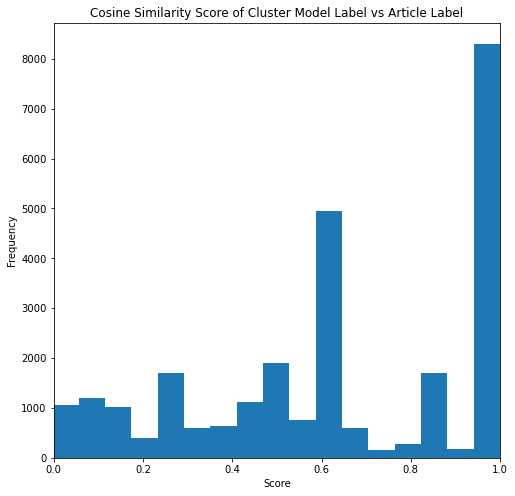

In [69]:
#Plot histogram of cosine similarity score using matplotlib
data = df_with_scores['cosine_similarity_score_rounded']
plt.figure(figsize=(8,8))
plt.hist(data,bins=20)
plt.title('Cosine Similarity Score of Cluster Model Label vs Article Label')
plt.xlabel('Score')
plt.ylabel('Frequency')
plt.xlim([0, 1])
plt.show();

In [92]:
#Plot histogram of cosine similarity score using plotly express
fig = px.histogram(df_with_scores, x="cosine_similarity_score_rounded",nbins=20)
layout = go.Layout(title="Cosine Similarity Score of Cluster Model Label vs Article Label", 
                   boxmode='group')
fig.update_xaxes(dtick=0.2)
fig.update_layout(layout,
    width=600,
    height=500,
    xaxis_range=[0,1],
    xaxis_title="Score",
    yaxis_title="Count")
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})
fig.show()

In [107]:
df_with_scores['cosine_similarity_score_rounded'].value_counts(normalize=True)

 1.00    0.308822
 0.64    0.175407
           ...   
-0.10    0.000037
-0.03    0.000037
Name: cosine_similarity_score_rounded, Length: 90, dtype: float64

In [121]:
#Run a loop to determine percent of articles at or above a designated range
min_pct = 50,60,70,80,90,95
for pct in min_pct:
    num_articles=df_with_scores[df_with_scores['cosine_similarity_score_rounded']>=(pct/100)]
    print(f'% Articles with at least {pct}% score: {round((len(num_articles)/len(df_with_scores)*100),1)}')

% Articles with at least 50% score: 69.4
% Articles with at least 60% score: 60.0
% Articles with at least 70% score: 39.8
% Articles with at least 80% score: 37.8
% Articles with at least 90% score: 31.2
% Articles with at least 95% score: 30.9


In [71]:
#Drop columns not needed
df_with_scores.drop(columns=['Article text_cleaned','Article text_tokens','cosine_similarity_score'],inplace=True)
df_with_scores.head()

,Year published,Month_year published,Category,Section,Article text,cluster ID,cluster category,cosine_similarity_score_rounded
0,2021,2021-07,news,world,"(CNN)Right now, there's a shortage of truck d...",22,technology,0.17
1,2021,2021-05,news,world,(CNN)Working in a factory or warehouse can me...,22,technology,0.17
2,2021,2021-06,news,asia,"(CNN)In a Hong Kong warehouse, a swarm of aut...",22,technology,0.32
4,2022,2022-03,business,investing,New York (CNN Business)March Madness isn't jus...,18,economy,0.62
5,2022,2022-03,business,investing,A version of this story first appeared in CNN ...,18,economy,0.62


In [75]:
#Save to csv
df_with_scores.to_csv('df_with_scores_final.csv',index=False)

In [130]:
#View all rows
pd.set_option('display.max_rows',None) 


In [128]:
#Reset df display settings
pd.reset_option('display.max_rows')
pd.reset_option('display.max_colwidth')

In [133]:
df_with_scores.sort_values('cosine_similarity_score_rounded', axis = 0, ascending = False)

,Year published,Month_year published,Category,Section,Article text,cluster ID,cluster category,cosine_similarity_score_rounded
18786,2015,2015-04,sport,sport,"(CNN)She may be nearing 101 years old, but Mi...",6,sport,1.00
20243,2015,2015-12,sport,sport,Story highlightsProsecutors allege officials w...,6,sport,1.00
20214,2015,2015-12,sport,sport,Story highlightsFury loses one of his belts le...,6,sport,1.00
20217,2015,2015-12,sport,sport,"Iten, Kenya (CNN)Overlooking Kenya's Great Rif...",6,sport,1.00
20218,2015,2015-12,sport,sport,Story highlightsNBA rookies hire fashion help ...,6,sport,1.00
20221,2015,2015-12,sport,golf,Story highlightsDonald Trump calls for U.S. Mu...,1,golf,1.00
20222,2015,2015-12,sport,golf,Story highlightsWatson vows to quit if he beco...,1,golf,1.00
20228,2015,2015-12,sport,sport,Story highlightsAngela Lee is Asia's fast-risi...,6,sport,1.00
20237,2015,2015-12,sport,golf,Story highlightsTiger Woods at all-time low in...,1,golf,1.00
20238,2015,2015-12,sport,sport,Story highlightsBode Miller says he will likel...,6,sport,1.00
